# An Exploration of Seattle Airbnb Data
Three main questions for Airbnb properties across Seattle, Washington:
- What is the distribution of Airbnb property prices?
- What do the ratings about the properties tell us?
- Can we predict the price, or ratings, of an Airbnb property price per night based on the available data? 

### Downloading Data from Kaggle

In [1]:
import os
os.environ['KAGGLE_USERNAME'] = "danieldacruz7"
os.environ['KAGGLE_KEY'] = "b71e09eacd49749ac84b41eafee87b2b"

from kaggle.api.kaggle_api_extended import KaggleApi # Import Kaggle API Library 
api = KaggleApi()
api.authenticate()

api.dataset_list_files('airbnb/seattle').files # Listing downloadable files

[listings.csv, calendar.csv, reviews.csv]

In [2]:
api.dataset_download_files('airbnb/seattle') # Download data 
!unzip '/content/seattle.zip' # Extracting zipped files 

Archive:  /content/seattle.zip
  inflating: calendar.csv            
  inflating: listings.csv            
  inflating: reviews.csv             


### Importing Libraries

In [3]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as colors
import seaborn as sns

from sklearn.cluster import KMeans # Importing K-Means algorithm 
from sklearn.impute import KNNImputer # Importing K Nearest Neighbors Algorithm
from sklearn.linear_model import LinearRegression # Importing Linear Regression model 
from sklearn.metrics import mean_squared_error # Evaluation metric 
from sklearn.model_selection import train_test_split # Preprocessing for training and testing data splits 

from yellowbrick.cluster import KElbowVisualizer # Importing Elbow Method Library

import folium # plotting library for geospatial data
from folium import plugins
from geopy.geocoders import Nominatim # Library for extracting co-ordinates data

In [4]:
# Opening and viewing data 
df = pd.read_csv('/content/listings.csv') 
df.head()

,id,listing_url,scrape_id,last_scraped,name,summary,space,description,experiences_offered,neighborhood_overview,notes,transit,thumbnail_url,medium_url,picture_url,xl_picture_url,host_id,host_url,host_name,host_since,host_location,host_about,host_response_time,host_response_rate,host_acceptance_rate,host_is_superhost,host_thumbnail_url,host_picture_url,host_neighbourhood,host_listings_count,host_total_listings_count,host_verifications,host_has_profile_pic,host_identity_verified,street,neighbourhood,neighbourhood_cleansed,neighbourhood_group_cleansed,city,state,...,bedrooms,beds,bed_type,amenities,square_feet,price,weekly_price,monthly_price,security_deposit,cleaning_fee,guests_included,extra_people,minimum_nights,maximum_nights,calendar_updated,has_availability,availability_30,availability_60,availability_90,availability_365,calendar_last_scraped,number_of_reviews,first_review,last_review,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,requires_license,license,jurisdiction_names,instant_bookable,cancellation_policy,require_guest_profile_picture,require_guest_phone_verification,calculated_host_listings_count,reviews_per_month
0,241032,https://www.airbnb.com/rooms/241032,20160104002432,2016-01-04,Stylish Queen Anne Apartment,NaN,Make your self at home in this charming one-be...,Make your self at home in this charming one-be...,none,NaN,NaN,NaN,NaN,NaN,https://a1.muscache.com/ac/pictures/67560560/c...,NaN,956883,https://www.airbnb.com/users/show/956883,Maija,2011-08-11,"Seattle, Washington, United States","I am an artist, interior designer, and run a s...",within a few hours,96%,100%,f,https://a0.muscache.com/ac/users/956883/profil...,https://a0.muscache.com/ac/users/956883/profil...,Queen Anne,3.0,3.0,"['email', 'phone', 'reviews', 'kba']",t,t,"Gilman Dr W, Seattle, WA 98119, United States",Queen Anne,West Queen Anne,Queen Anne,Seattle,WA,...,1.0,1.0,Real Bed,"{TV,""Cable TV"",Internet,""Wireless Internet"",""A...",NaN,$85.00,NaN,NaN,NaN,NaN,2,$5.00,1,365,4 weeks ago,t,14,41,71,346,2016-01-04,207,2011-11-01,2016-01-02,95.0,10.0,10.0,10.0,10.0,9.0,10.0,f,NaN,WASHINGTON,f,moderate,f,f,2,4.07
1,953595,https://www.airbnb.com/rooms/953595,20160104002432,2016-01-04,Bright & Airy Queen Anne Apartment,Chemically sensitive? We've removed the irrita...,"Beautiful, hypoallergenic apartment in an extr...",Chemically sensitive? We've removed the irrita...,none,"Queen Anne is a wonderful, truly functional vi...",What's up with the free pillows? Our home was...,"Convenient bus stops are just down the block, ...",https://a0.muscache.com/ac/pictures/14409893/f...,https://a0.muscache.com/im/pictures/14409893/f...,https://a0.muscache.com/ac/pictures/14409893/f...,https://a0.muscache.com/ac/pictures/14409893/f...,5177328,https://www.airbnb.com/users/show/5177328,Andrea,2013-02-21,"Seattle, Washington, United States",Living east coast/left coast/overseas. Time i...,within an hour,98%,100%,t,https://a0.muscache.com/ac/users/5177328/profi...,https://a0.muscache.com/ac/users/5177328/profi...,Queen Anne,6.0,6.0,"['email', 'phone', 'facebook', 'linkedin', 're...",t,t,"7th Avenue West, Seattle, WA 98119, United States",Queen Anne,West Queen Anne,Queen Anne,Seattle,WA,...,1.0,1.0,Real Bed,"{TV,Internet,""Wireless Internet"",Kitchen,""Free...",NaN,$150.00,"$1,000.00","$3,000.00",$100.00,$40.00,1,$0.00,2,90,today,t,13,13,16,291,2016-01-04,43,2013-08-19,2015-12-29,96.0,10.0,10.0,10.0,10.0,10.0,10.0,f,NaN,WASHINGTON,f,strict,t,t,6,1.48
2,3308979,https://www.airbnb.com/rooms/3308979,20160104002432,2016-01-04,New Modern House-Amazing water view,New modern house built in 2013. Spectacular s...,"Our house is modern, light and fresh with a wa...",New modern house built in 2013. Spectacular s...,none,Upper Queen Anne is a charming neighborhood fu...,Our house is located just 5 short blocks to To...,A bus stop is just 2 blocks away. Easy bus a...,NaN,NaN,

### Raw Data Processing 
- The objective is to:
  - Remove unnecesssary features
  - Change data types 
  - Replace NaN values

In [5]:
# Filtering Dataframe for relevant features
df = df.filter(['id', 'host_response_rate', 'host_acceptance_rate',
                          'host_is_superhost', 'latitude', 'longitude', 'neighbourhood'
                          'propery_type', 'room_type', 'accomodates',
                          'bathrooms', 'bedrooms', 'beds', 'square_feet',
                          'price', 'review_scores_rating', 'review_scores_accuracy', 
                          'review_scores_cleanliness', 'review_scores_checkin', 'review_scores_communication', 
                          'review_scores_location', 'review_scores_value', 'reviews_per_month'
                          ])
df.head()

,id,host_response_rate,host_acceptance_rate,host_is_superhost,latitude,longitude,room_type,bathrooms,bedrooms,beds,square_feet,price,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,reviews_per_month
0,241032,96%,100%,f,47.636289,-122.371025,Entire home/apt,1.0,1.0,1.0,NaN,$85.00,95.0,10.0,10.0,10.0,10.0,9.0,10.0,4.07
1,953595,98%,100%,t,47.639123,-122.365666,Entire home/apt,1.0,1.0,1.0,NaN,$150.00,96.0,10.0,10.0,10.0,10.0,10.0,10.0,1.48
2,3308979,67%,100%,f,47.629724,-122.369483,Entire home/apt,4.5,5.0,7.0,NaN,$975.00,97.0,10.0,10.0,10.0,10.0,10.0,10.0,1.15
3,7421966,NaN,NaN,f,47.638473,-122.369279,Entire home/apt,1.0,0.0,2.0,NaN,$100.00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,278830,100%,NaN,f,47.632918,-122.372471,Entire home/apt,2.0,3.0,3.0,NaN,$450.00,92.0,9.0,9.0,10.0,10.0,9.0,9.0,0.89


In [6]:
# Viewing number of NaN values present in data per column
df.isnull().sum()

id                                0
host_response_rate              523
host_acceptance_rate            773
host_is_superhost                 2
latitude                          0
longitude                         0
room_type                         0
bathrooms                        16
bedrooms                          6
beds                              1
square_feet                    3721
price                             0
review_scores_rating            647
review_scores_accuracy          658
review_scores_cleanliness       653
review_scores_checkin           658
review_scores_communication     651
review_scores_location          655
review_scores_value             656
reviews_per_month               627
dtype: int64

In [7]:
# Viewing number of NaN values as a percentage of total values
null_count = []
for i in df:
    value = df[i].isnull().sum()
    null_count.append(value)

print("Percentage of null values in each column:")
for i in range(len(null_count)-1):
    print("{}: {:.2f}%".format(df.columns[i], (null_count[i]/df.shape[0] * 100)))

Percentage of null values in each column:
id: 0.00%
host_response_rate: 13.70%
host_acceptance_rate: 20.25%
host_is_superhost: 0.05%
latitude: 0.00%
longitude: 0.00%
room_type: 0.00%
bathrooms: 0.42%
bedrooms: 0.16%
beds: 0.03%
square_feet: 97.46%
price: 0.00%
review_scores_rating: 16.95%
review_scores_accuracy: 17.23%
review_scores_cleanliness: 17.10%
review_scores_checkin: 17.23%
review_scores_communication: 17.05%
review_scores_location: 17.16%
review_scores_value: 17.18%


In [8]:
# Viewing data types of each column
df.dtypes

id                               int64
host_response_rate              object
host_acceptance_rate            object
host_is_superhost               object
latitude                       float64
longitude                      float64
room_type                       object
bathrooms                      float64
bedrooms                       float64
beds                           float64
square_feet                    float64
price                           object
review_scores_rating           float64
review_scores_accuracy         float64
review_scores_cleanliness      float64
review_scores_checkin          float64
review_scores_communication    float64
review_scores_location         float64
review_scores_value            float64
reviews_per_month              float64
dtype: object

In [9]:
# Further processing of data 
df['host_response_rate'] = df['host_response_rate'].str[:-1].astype(float) # Removing percentage sign, and converting value into float
df['host_acceptance_rate'] = df['host_acceptance_rate'].str[:-1].astype(float) # Removing percentage sign, and converting value into float
df['price'] = df['price'].str[1:].replace(['1,000.00'],'1000.00').astype(float) # Specific processing of error producing value 
df.drop('square_feet', axis=1, inplace=True) # Far too many NaN values for square feet. This column will be dropped. Imputation is likely to be biased

In [10]:
# Processing of categorical values 
# All categorical values will be converted to numeric values
new_list = []

for i in range(0, df.shape[1]):     
    if (df.iloc[:, i].dtypes == 'object'):
        df.iloc[:, i] = pd.Categorical(df.iloc[:, i])
        df.iloc[:, i] = df.iloc[:, i].cat.codes 
        df.iloc[:, i] = df.iloc[:, i].astype('object')
         
        new_list.append(df.columns[i])

In [11]:
df.head()

,id,host_response_rate,host_acceptance_rate,host_is_superhost,latitude,longitude,room_type,bathrooms,bedrooms,beds,price,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,reviews_per_month
0,241032,96.0,100.0,0,47.636289,-122.371025,0,1.0,1.0,1.0,85.0,95.0,10.0,10.0,10.0,10.0,9.0,10.0,4.07
1,953595,98.0,100.0,1,47.639123,-122.365666,0,1.0,1.0,1.0,150.0,96.0,10.0,10.0,10.0,10.0,10.0,10.0,1.48
2,3308979,67.0,100.0,0,47.629724,-122.369483,0,4.5,5.0,7.0,975.0,97.0,10.0,10.0,10.0,10.0,10.0,10.0,1.15
3,7421966,NaN,NaN,0,47.638473,-122.369279,0,1.0,0.0,2.0,100.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,278830,100.0,NaN,0,47.632918,-122.372471,0,2.0,3.0,3.0,450.0,92.0,9.0,9.0,10.0,10.0,9.0,9.0,0.89


In [12]:
df.describe()

,id,host_response_rate,host_acceptance_rate,latitude,longitude,bathrooms,bedrooms,beds,price,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,reviews_per_month
count,3.818000e+03,3295.000000,3045.000000,3818.000000,3818.000000,3802.000000,3812.000000,3817.000000,3818.000000,3171.000000,3160.000000,3165.000000,3160.000000,3167.000000,3163.000000,3162.000000,3191.000000
mean,5.550111e+06,94.886798,99.967159,47.628961,-122.333103,1.259469,1.307712,1.735394,127.976166,94.539262,9.636392,9.556398,9.786709,9.809599,9.608916,9.452245,2.078919
std,2.962660e+06,11.866705,1.812201,0.043052,0.031745,0.590369,0.883395,1.139480,90.250022,6.606083,0.698031,0.797274,0.595499,0.568211,0.629053,0.750259,1.822348
min,3.335000e+03,17.000000,0.000000,47.505088,-122.417219,0.000000,0.000000,1.000000,20.000000,20.000000,2.000000,3.000000,2.000000,2.000000,4.000000,2.000000,0.020000
25%,3.258256e+06,98.000000,100.000000,47.609418,-122.354320,1.000000,1.000000,1.000000,75.000000,93.000000,9.000000,9.000000,10.000000,10.000000,9.000000,9.000000,0.695000
50%,6.118244e+06,100.000000,100.000000,47.623601,-122.328874,1.000000,1.000000,1.000000,100.000000,96.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,1.540000
75%,8.035127e+06,100.000000,100.000000,47.662694,-122.310800,1.000000,2.000000,2.000000,150.000000,99.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,3.000000
max,1.034016e+07,100.000000,100.000000,47.733358,-122.240607,8.000000,7.000000,15.000000,1000.000000,100.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,12.150000


Observation:
- After observing the data, we find the values to be in range. There are no extreme outliers. All maximum values make sense and representative of the actual data. Since processing of data into appropriate types, we can now impute values that will replace NaN values. 

- This can be seen in as max values are within range, and there are no negative numbers that are out of range - except for longitude values. We can carry on to imputation stage. 

### Imputation of Missing Values 
- The KNN algorithm is choosen for imputation. This provides a more representative form of imputation since that data is placed as close as possible to klusters within the dataset. 
-Removing NaN values or imputing with mean values may introduce a significant bias within the data. KNN is preferred.

In [13]:
# K Nearest Neighbours algorithm is used to replace values with its nearest neighbours - or most similar row data
df_final = pd.DataFrame(KNNImputer(n_neighbors=3, weights='uniform', metric='nan_euclidean').fit(df).transform(df), columns = df.columns)

### Confirming Data Processing Success
- The objective here is to view whether the data is appropriate for exploration. This means the values make sense within its context, the data types are appropriate for modelling and missing values have been removed. 




In [14]:
df_final.head()

,id,host_response_rate,host_acceptance_rate,host_is_superhost,latitude,longitude,room_type,bathrooms,bedrooms,beds,price,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,reviews_per_month
0,241032.0,96.0,100.0,0.0,47.636289,-122.371025,0.0,1.0,1.0,1.0,85.0,95.000000,10.0,10.000000,10.000000,10.000000,9.0,10.000000,4.070000
1,953595.0,98.0,100.0,1.0,47.639123,-122.365666,0.0,1.0,1.0,1.0,150.0,96.000000,10.0,10.000000,10.000000,10.000000,10.0,10.000000,1.480000
2,3308979.0,67.0,100.0,0.0,47.629724,-122.369483,0.0,4.5,5.0,7.0,975.0,97.000000,10.0,10.000000,10.000000,10.000000,10.0,10.000000,1.150000
3,7421966.0,100.0,100.0,0.0,47.638473,-122.369279,0.0,1.0,0.0,2.0,100.0,95.333333,10.0,9.666667,9.666667,9.666667,9.0,9.333333,3.316667
4,278830.0,100.0,100.0,0.0,47.632918,-122.372471,0.0,2.0,3.0,3.0,450.0,92.000000,9.0,9.000000,10.000000,10.000000,9.0,9.000000,0.890000


In [15]:
df_final.dtypes

id                             float64
host_response_rate             float64
host_acceptance_rate           float64
host_is_superhost              float64
latitude                       float64
longitude                      float64
room_type                      float64
bathrooms                      float64
bedrooms                       float64
beds                           float64
price                          float64
review_scores_rating           float64
review_scores_accuracy         float64
review_scores_cleanliness      float64
review_scores_checkin          float64
review_scores_communication    float64
review_scores_location         float64
review_scores_value            float64
reviews_per_month              float64
dtype: object

In [16]:
df_final.isnull().sum()

id                             0
host_response_rate             0
host_acceptance_rate           0
host_is_superhost              0
latitude                       0
longitude                      0
room_type                      0
bathrooms                      0
bedrooms                       0
beds                           0
price                          0
review_scores_rating           0
review_scores_accuracy         0
review_scores_cleanliness      0
review_scores_checkin          0
review_scores_communication    0
review_scores_location         0
review_scores_value            0
reviews_per_month              0
dtype: int64

In [17]:
df.describe()

,id,host_response_rate,host_acceptance_rate,latitude,longitude,bathrooms,bedrooms,beds,price,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,reviews_per_month
count,3.818000e+03,3295.000000,3045.000000,3818.000000,3818.000000,3802.000000,3812.000000,3817.000000,3818.000000,3171.000000,3160.000000,3165.000000,3160.000000,3167.000000,3163.000000,3162.000000,3191.000000
mean,5.550111e+06,94.886798,99.967159,47.628961,-122.333103,1.259469,1.307712,1.735394,127.976166,94.539262,9.636392,9.556398,9.786709,9.809599,9.608916,9.452245,2.078919
std,2.962660e+06,11.866705,1.812201,0.043052,0.031745,0.590369,0.883395,1.139480,90.250022,6.606083,0.698031,0.797274,0.595499,0.568211,0.629053,0.750259,1.822348
min,3.335000e+03,17.000000,0.000000,47.505088,-122.417219,0.000000,0.000000,1.000000,20.000000,20.000000,2.000000,3.000000,2.000000,2.000000,4.000000,2.000000,0.020000
25%,3.258256e+06,98.000000,100.000000,47.609418,-122.354320,1.000000,1.000000,1.000000,75.000000,93.000000,9.000000,9.000000,10.000000,10.000000,9.000000,9.000000,0.695000
50%,6.118244e+06,100.000000,100.000000,47.623601,-122.328874,1.000000,1.000000,1.000000,100.000000,96.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,1.540000
75%,8.035127e+06,100.000000,100.000000,47.662694,-122.310800,1.000000,2.000000,2.000000,150.000000,99.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,3.000000
max,1.034016e+07,100.000000,100.000000,47.733358,-122.240607,8.000000,7.000000,15.000000,1000.000000,100.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,12.150000


As we can obeserve, the data contains no missing values. This means we can move onto data exploration. 

# Data Exploration 

### Plotting all Airbnb locations in Seattle, Washington

In [18]:
location_df = df.filter(['latitude', 'longitude']) # Obtaining only relevant values for Airbnb coordinates

address = 'Seattle, Washington'

geolocator = Nominatim(user_agent="foursquare_agent")
location = geolocator.geocode(address)
latitude = location.latitude
longitude = location.longitude
print('The central coordinates of Seattle, Washington:  ({}, {})'.format(latitude, longitude))

The central coordinates of Seattle, Washington:  (47.6038321, -122.3300624)


In [19]:
map_of_seattle = folium.Map(location=[latitude, longitude], zoom_start=11.4)


for lat, lng in zip(location_df['latitude'], location_df['longitude']):
    if lat and lng == 'unknown':
        continue
    else:
        folium.CircleMarker(
            [lat, lng],
            radius=1,
            color='blue',
            fill=True,
            fill_color='#3186cc',
            opacity=0.4,
            fill_opacity=0.1,
            parse_html=False).add_to(map_of_seattle)

        label ='Central Seattle'
        label = folium.Popup(label, parse_html=True)
        folium.CircleMarker(
            [latitude, longitude],
            radius=5,
            popup=label,
            color='red',
            fill=True,
            fill_color='#3186cc',
            parse_html=False).add_to(map_of_seattle)
map_of_seattle

### Fitting Location Data onto KMeans model
- The model will be used to classify Airbnb properties into regional clusters. Rental prices are known to be affected by location. 

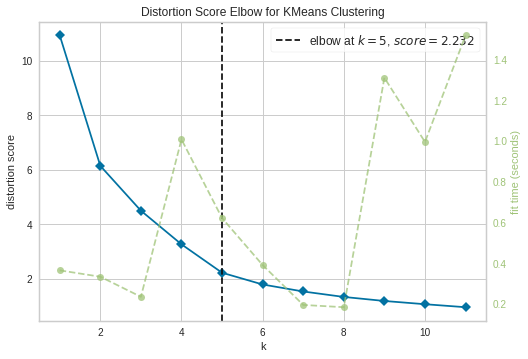

In [20]:
model = KMeans()
visualizer = KElbowVisualizer(model, k=(1,12)) # Loop through model to find ideal number of clusters within the data

visualizer.fit(location_df)
visualizer.show()

Note: The graph above indicates that the ideal number of clusters are 5.

In [21]:
# Fitting location data using five clusters
kmeans = KMeans(n_clusters=5, random_state=0).fit(location_df)

location_df['cluster'] = kmeans.labels_ # Adding extra column to the location dataframe to allocate data to separate groups
location_df.head()

,latitude,longitude,cluster
0,47.636289,-122.371025,4
1,47.639123,-122.365666,4
2,47.629724,-122.369483,4
3,47.638473,-122.369279,4
4,47.632918,-122.372471,4


In [22]:
kmeans = KMeans(n_clusters=5, random_state=0).fit(location_df)

df_final['cluster'] = kmeans.labels_
df_final.head()

,id,host_response_rate,host_acceptance_rate,host_is_superhost,latitude,longitude,room_type,bathrooms,bedrooms,beds,price,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,reviews_per_month,cluster
0,241032.0,96.0,100.0,0.0,47.636289,-122.371025,0.0,1.0,1.0,1.0,85.0,95.000000,10.0,10.000000,10.000000,10.000000,9.0,10.000000,4.070000,2
1,953595.0,98.0,100.0,1.0,47.639123,-122.365666,0.0,1.0,1.0,1.0,150.0,96.000000,10.0,10.000000,10.000000,10.000000,10.0,10.000000,1.480000,2
2,3308979.0,67.0,100.0,0.0,47.629724,-122.369483,0.0,4.5,5.0,7.0,975.0,97.000000,10.0,10.000000,10.000000,10.000000,10.0,10.000000,1.150000,2
3,7421966.0,100.0,100.0,0.0,47.638473,-122.369279,0.0,1.0,0.0,2.0,100.0,95.333333,10.0,9.666667,9.666667,9.666667,9.0,9.333333,3.316667,2
4,278830.0,100.0,100.0,0.0,47.632918,-122.372471,0.0,2.0,3.0,3.0,450.0,92.000000,9.0,9.000000,10.000000,10.000000,9.0,9.000000,0.890000,2


In [23]:
map_of_regional_clusters = folium.Map(location=[latitude, longitude], zoom_start=11.4)

# setting colors for clusters
x = np.arange(5)
ys = [i + x + (i * x)**2 for i in range(5)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

# Marking cluster points for map
cluster_colors = []
for lat, lng, cluster in zip(location_df['latitude'], location_df['longitude'], location_df['cluster'] ):
    label = folium.Popup('Cluster ' + str(cluster), parse_html=True)
    folium.vector_layers.CircleMarker(
        [lat, lng],
        radius=1.5,
        popup=label,
        tooltip = 'Cluster ' + str(cluster),
        color=rainbow[cluster-1],
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=0.9).add_to(map_of_regional_clusters)
       
map_of_regional_clusters

# Price Distribution by Region

In [24]:
"""
  Due to seaplot functioning, I chose not to use a single dataframe as the values in the 
  graph change when adding annotation. Annotating mean and median values for illustrative purposes 
  helps viewer see description of pricing and rating.  

  This also allows custom placement of annotation.

"""
dataframe_cluster_0 = df_final[df_final['cluster'] == 0]
dataframe_cluster_1 = df_final[df_final['cluster'] == 1]
dataframe_cluster_2 = df_final[df_final['cluster'] == 2]
dataframe_cluster_3 = df_final[df_final['cluster'] == 3]
dataframe_cluster_4 = df_final[df_final['cluster'] == 4]

[Text(0.5, 0, 'Price ($)')]

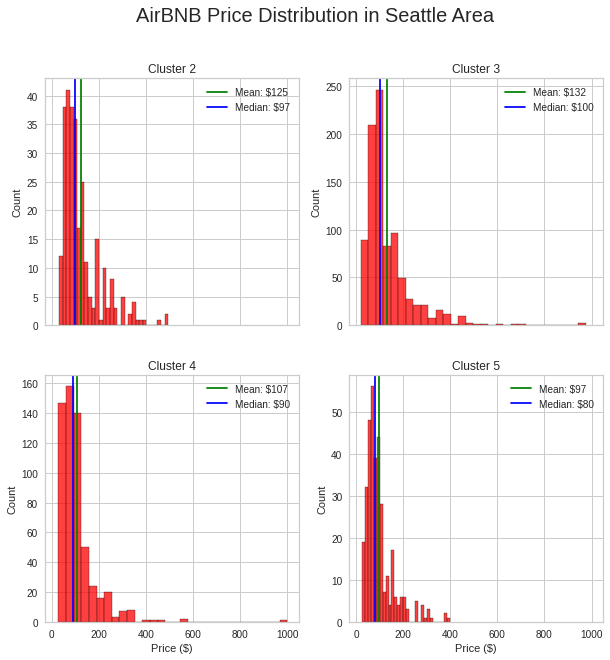

In [25]:
figure, axes = plt.subplots(2, 2, sharex=True, figsize=(10,10))
figure.suptitle('AirBNB Price Distribution in Seattle Area', fontsize=20)

"""
  Althought the K-Means model is relatively stable, it changes the allocation of clusters to different numbers
  after every iteration. The location of text is adjusted for illustrative purposes.

"""

axes[0, 0].set_title('Cluster 2')
axes[0, 1].set_title('Cluster 3')
axes[1, 0].set_title('Cluster 4')
axes[1, 1].set_title('Cluster 5')


sns.histplot(dataframe_cluster_1, x='price', ax=axes[0, 0], kde = False, color ='red', bins = 30)
axes[0, 0].axvline(x=dataframe_cluster_1['price'].mean(), color='green')
axes[0, 0].axvline(x=dataframe_cluster_1['price'].median(), color='blue')
axes[0, 0].legend(("Mean: ${}".format(int(dataframe_cluster_1['price'].mean())), 
                   "Median: ${}".format(int(dataframe_cluster_1['price'].median()))))
axes[0, 0].set(xlabel='Price ($)')

sns.histplot(dataframe_cluster_2, x='price', ax=axes[0, 1], kde = False, color ='red', bins = 30)
axes[0, 1].axvline(x=dataframe_cluster_2['price'].mean(), color='green')
axes[0, 1].axvline(x=dataframe_cluster_2['price'].median(), color='blue')
axes[0, 1].legend(("Mean: ${}".format(int(dataframe_cluster_2['price'].mean())), 
                   "Median: ${}".format(int(dataframe_cluster_2['price'].median()))))
axes[0, 1].set(xlabel='Price ($)')

sns.histplot(dataframe_cluster_3, x='price', ax=axes[1, 0], kde = False, color ='red', bins = 30)
axes[1, 0].axvline(x=dataframe_cluster_3['price'].mean(), color='green')
axes[1, 0].axvline(x=dataframe_cluster_3['price'].median(), color='blue')
axes[1, 0].legend(("Mean: ${}".format(int(dataframe_cluster_3['price'].mean())), 
                   "Median: ${}".format(int(dataframe_cluster_3['price'].median()))))
axes[1, 0].set(xlabel='Price ($)')

sns.histplot(dataframe_cluster_4, x='price', ax=axes[1, 1], kde = False, color ='red', bins = 30)
axes[1, 1].axvline(x=dataframe_cluster_4['price'].mean(), color='green')
axes[1, 1].axvline(x=dataframe_cluster_4['price'].median(), color='blue')
axes[1, 1].legend(("Mean: ${}".format(int(dataframe_cluster_4['price'].mean())), 
                   "Median: ${}".format(int(dataframe_cluster_4['price'].median()))))
axes[1, 1].set(xlabel='Price ($)')



Text(0.5, 0, 'Price ($)')

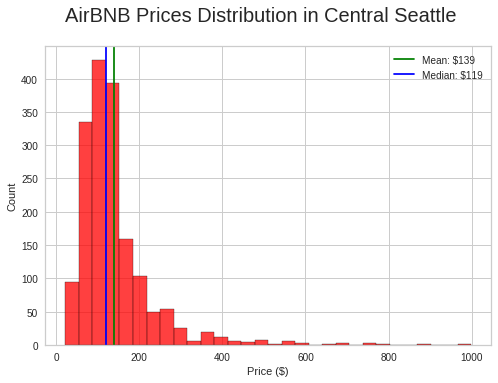

In [26]:
plt.suptitle('AirBNB Prices Distribution in Central Seattle' , fontsize=20)
sns.histplot(dataframe_cluster_0, x='price', kde = False, color ='red', bins = 30)
plt.axvline(x=dataframe_cluster_0['price'].mean(), color='green')
plt.axvline(x=dataframe_cluster_0['price'].median(), color='blue')
plt.legend(("Mean: ${}".format(int(dataframe_cluster_0['price'].mean())), 
            "Median: ${}".format(int(dataframe_cluster_0['price'].median()))))
plt.xlabel('Price ($)')

Observation: After viewing the data, it can be seen that the first cluster has both the highest mean and median values. This makes it the most expensive area in which to rent an Airbnb property. 

[Text(0.5, 0, 'Review Score Ratings (%)')]

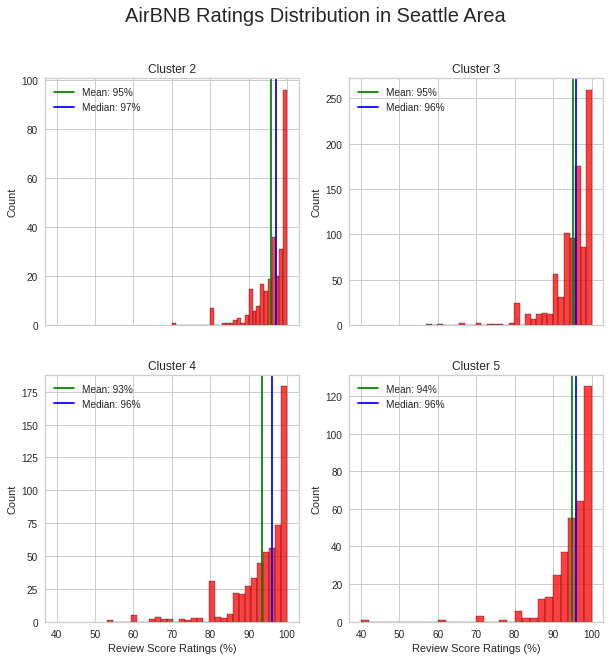

In [27]:
figure, axes = plt.subplots(2, 2, sharex=True, figsize=(10,10))
figure.suptitle('AirBNB Ratings Distribution in Seattle Area', fontsize=20)

"""
  Althought the K-Means model is relatively stable, it changes the allocation of clusters to different numbers
  after every iteration. The location of text is adjusted for illustrative purposes.
  
"""

axes[0, 0].set_title('Cluster 2')
axes[0, 1].set_title('Cluster 3')
axes[1, 0].set_title('Cluster 4')
axes[1, 1].set_title('Cluster 5')


sns.histplot(dataframe_cluster_1, x='review_scores_rating', ax=axes[0, 0], kde = False, color ='red', bins = 30)
axes[0, 0].axvline(x=dataframe_cluster_1['review_scores_rating'].mean(), color='green')
axes[0, 0].axvline(x=dataframe_cluster_1['review_scores_rating'].median(), color='blue')
axes[0, 0].legend(("Mean: {}%".format(int(dataframe_cluster_1['review_scores_rating'].mean())), 
                   "Median: {}%".format(int(dataframe_cluster_1['review_scores_rating'].median()))))
axes[0, 0].set(xlabel='Review Score Ratings (%)')

sns.histplot(dataframe_cluster_2, x='review_scores_rating', ax=axes[0, 1], kde = False, color ='red', bins = 30)
axes[0, 1].axvline(x=dataframe_cluster_2['review_scores_rating'].mean(), color='green')
axes[0, 1].axvline(x=dataframe_cluster_2['review_scores_rating'].median(), color='blue')
axes[0, 1].legend(("Mean: {}%".format(int(dataframe_cluster_2['review_scores_rating'].mean())), 
                   "Median: {}%".format(int(dataframe_cluster_2['review_scores_rating'].median()))))
axes[0, 1].set(xlabel='Review Score Ratings (%)')

sns.histplot(dataframe_cluster_3, x='review_scores_rating', ax=axes[1, 0], kde = False, color ='red', bins = 30)
axes[1, 0].axvline(x=dataframe_cluster_3['review_scores_rating'].mean(), color='green')
axes[1, 0].axvline(x=dataframe_cluster_3['review_scores_rating'].median(), color='blue')
axes[1, 0].legend(("Mean: {}%".format(int(dataframe_cluster_3['review_scores_rating'].mean())), 
                   "Median: {}%".format(int(dataframe_cluster_3['review_scores_rating'].median()))))
axes[1, 0].set(xlabel='Review Score Ratings (%)')

sns.histplot(dataframe_cluster_4, x='review_scores_rating', ax=axes[1, 1], kde = False, color ='red', bins = 30)
axes[1, 1].axvline(x=dataframe_cluster_4['review_scores_rating'].mean(), color='green')
axes[1, 1].axvline(x=dataframe_cluster_4['review_scores_rating'].median(), color='blue')
axes[1, 1].legend(("Mean: {}%".format(int(dataframe_cluster_4['review_scores_rating'].mean())), 
                   "Median: {}%".format(int(dataframe_cluster_4['review_scores_rating'].median()))))
axes[1, 1].set(xlabel='Review Score Ratings (%)')


Text(0.5, 0, 'Review Score Ratings (%)')

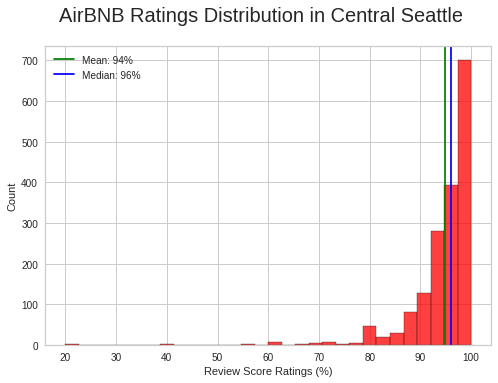

In [28]:
plt.suptitle('AirBNB Ratings Distribution in Central Seattle' , fontsize=20)
sns.histplot(dataframe_cluster_0, x='review_scores_rating', kde = False, color ='red', bins = 30)
plt.axvline(x=dataframe_cluster_0['review_scores_rating'].mean(), color='green')
plt.axvline(x=dataframe_cluster_0['review_scores_rating'].median(), color='blue')
plt.legend(("Mean: {}%".format(int(dataframe_cluster_0['review_scores_rating'].mean())), 
            "Median: {}%".format(int(dataframe_cluster_0['review_scores_rating'].median()))))
plt.xlabel('Review Score Ratings (%)')

Observation: We find that the data is skewed to the left. There are no outliers. It can also be seen that there is not much difference in the ratings of Airbnb properties across Seattle, Washington. The most expensive region does not necessarily mean that it will provide the most customter satisfaction. 

However, the ratings are relatively high. On a scale of 0-100, this indicates most people are very happy with their Airbnb properties. This could be a biased dataset. It might be best to gather more data from outside of Seattle, or observe the demographics of the population using the accomodation. 



In [29]:
map_of_seattle = folium.Map(location=[latitude, longitude], zoom_start=11.4)

for lat, lng in zip(dataframe_cluster_0['latitude'], dataframe_cluster_0['longitude']):
    if lat and lng == 'unknown':
        continue
    else:
        folium.CircleMarker(
            [lat, lng],
            radius=2,
            color='red',
            fill=True,
            fill_color='#3186cc',
            fill_opacity=0.3,
            parse_html=False).add_to(map_of_seattle)

for lat, lng in zip(dataframe_cluster_3['latitude'], dataframe_cluster_3['longitude']):
    if lat and lng == 'unknown':
        continue
    else:
        folium.CircleMarker(
            [lat, lng],
            radius=2,
            color='red',
            fill=True,
            fill_color='#3186cc',
            fill_opacity=0.2,
            parse_html=False).add_to(map_of_seattle)
map_of_seattle

## Correlation Matrix of the Data 

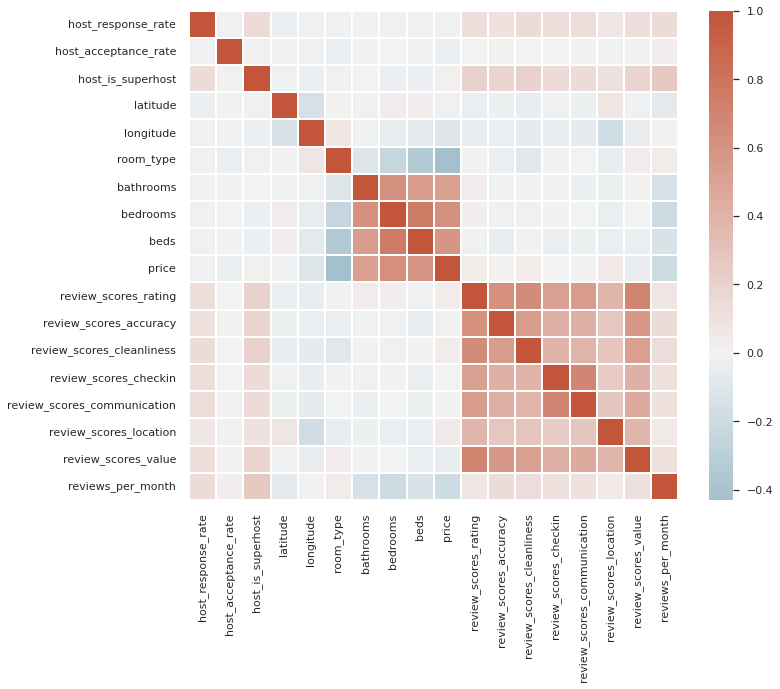

In [30]:
sns.set_theme(style="white")

# Obtaining correlation matrix
corr_df = df_final.copy().drop(['id', 'cluster'], axis=1)
corr = corr_df.corr()

# Matplotlib graph setup 
f, ax = plt.subplots(figsize=(11, 9))

# Generating Seaplot colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)

sns.heatmap(corr, cmap=cmap, vmax=1, center=0,
            square=True, linewidths=1, cbar_kws={"shrink": 1}, fmt=".2f")

Observation: We can see that there is a stronger correlation between the reviews scores, and weak correlations between price and number of bedrooms and beds. 

# Predicting AirBNB Price using Linear Regression

In [31]:
X = df_final.filter(['host_response_rate', 
                           'host_acceptance_rate', 'host_is_superhost', 'room_type', 
                           'bathrooms', 'bedrooms', 'beds', 'review_scores_rating',
                           'review_scores_accuracy', 'review_scores_cleanliness', 'review_scores_checkin',
                           'review_scores_communication', 'review_scores_location', 'review_scores_value', 
                           'reviews_per_month']).values

y = df_final['price'].values.reshape(-1,1)


X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=123)

lin_regression = LinearRegression().fit(X_train, y_train)
print('The R^2 value is: {:.2f}'.format(lin_regression.score(X_test, y_test)))

preds = lin_regression.predict(X_test)
rmse = np.sqrt(mean_squared_error(y_test, preds))
print("Root mean squared error: {:.2f}".format(rmse))

The R^2 value is: 0.53
Root mean squared error: 66.92


Note: This means the model can only explain 53% of the impact of the features on price. It has a general error of 67 both negatively and postively from the accurate price. 

In [32]:
X = df_final[['latitude', 'longitude', 'host_response_rate', 
                           'host_acceptance_rate', 'host_is_superhost', 'room_type', 
                           'bathrooms', 'bedrooms', 'beds',
                           'review_scores_accuracy', 'review_scores_cleanliness', 'review_scores_checkin',
                           'review_scores_communication', 'review_scores_location', 'review_scores_value', 
                           'reviews_per_month', 'price']].values
y = df_final['review_scores_rating'].values.reshape(-1,1)


X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=123)

lin_regression = LinearRegression().fit(X_train, y_train)


print('The R^2 value is: {:.2f}'.format(lin_regression.score(X_test, y_test)))
preds = lin_regression.predict(X_test)
rmse = np.sqrt(mean_squared_error(y_test, preds))
print("Root mean squared error: {:.2f}".format(rmse))

The R^2 value is: 0.59
Root mean squared error: 3.73


Note: This means the model can only explain 59% of the impact of the features on rating. It has a general error of 3.73% both negatively and postively from the accurate rating. This could be a biased dataset although the difference isn't far off from the accurate value.  

# Conclusion

To conclude our investigation, it is safe to say that the regions of Central Seattle and North-East Seattle will be the most expensive if you are looking to rent an Airbnb. The Central Seattle region makes intuitive sense as it is the main hub of Seattle - which is the case for most cities. The more people there are in a given area, the higher the demand for rentals. Therefore, Airbnb's will be more expensive in the city center. 

The second observation is that the overall rating for Airbnbs are quite high. The standard deviation of mean ratings is roughly 1 point - which indicates that it doesn't really matter where in Seattle you stay if you'd like to have a good rental experience. 

The final obeservation is that we aren't able to predict the price of an Airbnb per night based on the available data. There could be a myriad of explanations. It's possible that we may not have included all the most important factors, either within the dataset or outside of the dataset. There is a possibility that there is a better predictive model for the data. Although, the evaluation metrics don't reveal extraordinary results, they also don't reveal horrible results. 

In my opinion, an improved dataset will yield better results. A more intricate approach will increase the accuracy of the models. We could also include Natural Language Processing to analyze customer reviews, or obtain data such as distance from shopping centers, work offices, etc. As part of the first Udacity assignment, this might be out of the scope of the project as it will be an intensive process. 

So that concludes our investigation! I hope it was as enjoyable fro you to view as it was for me to produce. 